#Install

In [1]:
!pip install --upgrade --quiet accelerate bitsandbytes transformers qdrant-client fastembed qdrant-client[fastembed]

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.1/59.1 MB 17.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.1/10.1 MB 58.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 377.2/377.2 kB 12.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.5/108.5 kB 8.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 536.6/536.6 kB 23.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.6/61.6 kB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.4/17.4 MB 59.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.8/324.8 kB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 3.8 MB/s eta 0:00:00


In [2]:
!pip install -U transformers
!pip install -U huggingface_hub transformers
!pip install transformers psutil torch datasets

In [3]:
!apt -y install -qq aria2
!pip install -U diffusers

#!pip3 install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cpu

!pip uninstall -y tensorflow && pip install tensorflow-cpu

!pip install qwen-vl-utils

#!pip install git+https://github.com/huggingface/transformers



The following additional packages will be installed:
  libaria2-0 libc-ares2
The following NEW packages will be installed:
  aria2 libaria2-0 libc-ares2
0 upgraded, 3 newly installed, 0 to remove and 41 not upgraded.
Need to get 1,513 kB of archives.
After this operation, 5,441 kB of additional disk space will be used.
Selecting previously unselected package libc-ares2:amd64.
(Reading database ... 121689 files and directories currently installed.)
Preparing to unpack .../libc-ares2_1.18.1-1ubuntu0.22.04.3_amd64.deb ...
Unpacking libc-ares2:amd64 (1.18.1-1ubuntu0.22.04.3) ...
Selecting previously unselected package libaria2-0:amd64.
Preparing to unpack .../libaria2-0_1.36.0-1_amd64.deb ...
Unpacking libaria2-0:amd64 (1.36.0-1) ...
Selecting previously unselected package aria2.
Preparing to unpack .../aria2_1.36.0-1_amd64.deb ...
Unpacking aria2 (1.36.0-1) ...
Setting up libc-ares2:amd64 (1.18.1-1ubuntu0.22.04.3) ...
Setting up libaria2-0:amd64 (1.36.0-1) ...
Setting up aria2 (1.36.0-1) 

In [4]:
from google.colab import drive
drive.mount("/content/drive")


Mounted at /content/drive


In [5]:
# @title
import os
import sys

from dataclasses import dataclass
from functools import lru_cache
from typing import Any, Dict, List, Optional
from pathlib import Path
from qdrant_client import QdrantClient, models

from fastembed import TextEmbedding



@dataclass
class RagSettings:
    qdrant_host: str = os.getenv("QDRANT_HOST", "165.22.56.15")
    qdrant_port: int = int(os.getenv("QDRANT_PORT", 6333))
    qdrant_api_key: str | None = os.getenv("QDRANT_API_KEY")
    qdrant_collection: str = os.getenv("QDRANT_COLLECTION", "case_text_bge_v1_5")
    vector_name: str = os.getenv("QDRANT_VECTOR_NAME", "text")
    embed_model: str = os.getenv("EMBED_MODEL", "BAAI/bge-base-en-v1.5")
    embed_fallbacks: str = os.getenv("EMBED_MODEL_FALLBACKS", "")
    rag_top_k: int = int(os.getenv("RAG_TOP_K",2 ))
    context_prefix: str = os.getenv(
        "RAG_CONTEXT_PREFIX",
        "Use the following reference material when reasoning about the case:",
    )


rag_settings = RagSettings()


In [6]:
# @title
@lru_cache(maxsize=1)
def get_qdrant_client() -> QdrantClient:
    return QdrantClient(
        host=rag_settings.qdrant_host,
        port=rag_settings.qdrant_port,
        api_key=rag_settings.qdrant_api_key,
        prefer_grpc=False,
        timeout=120.0,
    )


def _candidate_embed_models() -> List[str]:
    env_fallbacks = []
    if rag_settings.embed_fallbacks:
        env_fallbacks = [model.strip() for model in rag_settings.embed_fallbacks.split(",") if model.strip()]
    hardcoded = [
        "qdrant/fastembed-multilingual-v1",
        "qdrant/fastembed-multilingual",
        "qdrant/fastembed-multilingual-v3"
        "BAAI/bge-m3",
        "BAAI/bge-base-en-v1.5",
    ]
    candidates: List[str] = [rag_settings.embed_model, *env_fallbacks, *hardcoded]
    seen: set[str] = set()
    unique_candidates: List[str] = []
    for model_name in candidates:
        if not model_name or model_name in seen:
            continue
        seen.add(model_name)
        unique_candidates.append(model_name)
    return unique_candidates


@lru_cache(maxsize=1)
def get_embedder() -> TextEmbedding:
    errors: List[str] = []
    for model_name in _candidate_embed_models():
        try:
            return TextEmbedding(model_name=model_name)
        except ValueError as exc:
            errors.append(f"{model_name}: {exc}")
        except Exception as exc:
            errors.append(f"{model_name}: {exc}")
    error_msg = "Failed to initialise embedding model. "
    if errors:
        error_msg += "; ".join(errors)
    raise RuntimeError(error_msg)


def embed_query(query: str) -> List[float]:
    embedder = get_embedder()
    vectors = list(embedder.embed([query]))
    if not vectors:
        raise ValueError("Failed to compute embedding for query.")
    vector = vectors[0]

    # Log the dimension of the embedding vector
    dimension = len(vector)
    print(f"The dimension of the embedding vector is: {dimension}")  # Log the dimension

    return vector.tolist() if hasattr(vector, "tolist") else vector


def retrieve_references(
    query: str,
    top_k: Optional[int] = None,
    *,
    search_limit: int = 50,          # <-- lấy 50 candidates từ Qdrant
    dedupe_by_case_id: bool = True,  # <-- tránh trùng case_id
) -> List[Dict[str, Any]]:
    top_k = top_k or rag_settings.rag_top_k
    client = get_qdrant_client()

    try:
        vector = embed_query(query)

        result = client.query_points(
            collection_name=rag_settings.qdrant_collection,
            query=vector,
            limit=search_limit,      # <-- IMPORTANT: lấy 50
            with_payload=True,
            with_vectors=False,
            # using=rag_settings.vector_name,  # nếu dùng named vectors
        )

        hits = getattr(result, "points", []) or []
    except Exception as e:
        print(f"[RAG] Search error: {type(e).__name__}: {e}")
        return []

    # Deduplicate theo case_id, và chỉ lấy tối đa top_k case unique
    unique_hits = []
    seen_keys: set = set()

    for hit in hits:
        payload = hit.payload or {}
        case_id = payload.get("case_id")

        # key dedupe: ưu tiên case_id; nếu không có thì dùng hit.id
        key = case_id if (dedupe_by_case_id and case_id is not None) else hit.id

        if key in seen_keys:
            continue

        seen_keys.add(key)
        unique_hits.append(hit)

        if len(unique_hits) >= top_k:   # <-- chỉ giữ 2 case (top_k)
            break

    return [
        {
            "id": hit.id,
            "score": hit.score,
            "payload": hit.payload or {},
        }
        for hit in unique_hits
    ]

STRUCTURED_DATA_ROOT = Path("/content/drive/MyDrive/Project-AI/structured-data-json")


def load_structured_json(case_id: str) -> Dict[str, Any]:
    """Load full structured JSON for a case."""
    json_path = STRUCTURED_DATA_ROOT / f"{case_id}.json"
    if not json_path.exists():
        return {}
    try:
        return yaml.safe_load(json_path.read_text(encoding="utf-8"))
    except Exception:
        return {}



def format_references(references: List[Dict[str, Any]]) -> str:
    if not references:
        return ""

    chunks: List[str] = []

    for idx, ref in enumerate(references, start=1):
        payload = ref.get("payload", {})
        case_id = payload.get("case_id")
        score = ref.get("score")

        # 1. Load structured JSON
        case_json = load_structured_json(case_id) if case_id else {}

        # 2. Format JSON thành text
        if case_json:
            fields = []
            for k, v in case_json.items():
                fields.append(f"**{k.replace('_', ' ').title()}**: {v}")
            summary = "\n".join(fields)
        else:
            summary = "No JSON data available."

        # 3. Title
        title = f"Case {case_id}" if case_id else f"Reference {idx}"

        # 4. Prefix with score if available
        if score is not None:
            prefix = f"## {title} (score={score:.3f})\n"
        else:
            prefix = f"## {title}\n"

        chunks.append(prefix + summary)

    return "\n\n".join(chunks)

def gather_rag_context(
    query: Optional[str] = None,
    top_k: Optional[int] = None,
    *,
    search_limit: int = 50,
) -> tuple[str, List[Dict[str, Any]]]:
    if not query:
        return "", []
    references = retrieve_references(query, top_k=top_k, search_limit=search_limit)
    return format_references(references), references



#1. Load Model


In [7]:
from transformers import Qwen2VLForConditionalGeneration, AutoTokenizer, AutoProcessor
from qwen_vl_utils import process_vision_info
import torch


# default: Load the model on the available device(s)
model = Qwen2VLForConditionalGeneration.from_pretrained(
    "Qwen/Qwen2-VL-2B-Instruct",
    torch_dtype=torch.float16,
    device_map="auto"
)
# default processer
processor = AutoProcessor.from_pretrained("Qwen/Qwen2-VL-2B-Instruct")

config.json: 0.00B [00:00, ?B/s]

model.safetensors.index.json: 0.00B [00:00, ?B/s]

Fetching 2 files:   0%|          | 0/2 [00:00<?, ?it/s]

Loading weights:   0%|          | 0/729 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/272 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/347 [00:00<?, ?B/s]

chat_template.json: 0.00B [00:00, ?B/s]

The image processor of type `Qwen2VLImageProcessor` is now loaded as a fast processor by default, even if the model checkpoint was saved with a slow processor. This is a breaking change and may produce slightly different outputs. To continue using the slow processor, instantiate this class with `use_fast=False`. 


tokenizer_config.json: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

#2. Prompt Template

In [8]:
# Install required packages
!pip install pyyaml pytest pytest-snapshot

import yaml
import os
from pathlib import Path

# Create directory structure
Path("prompts/medgemma").mkdir(parents=True, exist_ok=True)
# medgemma_prompt.yaml

# Template 1: General_Explain
general_explain = """
name: "general_explain"
description: "Template for general medical explanations"
system_prompt: |
  You are a medical educator providing explanatory information.
  - Explain medical concepts in accessible language. cite sources from the provided context using markers like [1], [2] at the end of relevant paragraphs.
  - Use analogies and examples when helpful
  - Cite sources for factual information, Provide accurate source citations in [number] format.
  - Ensure all references include clickable URLs
  - Distinguish between established facts and areas of uncertainty

  ### Format your response as:
  - **Question**: {question}
  - **Answer**: [Direct answer to the question, answer with citations format [number] at the end of cited/relevant paragraphs.]
  - **References**: [list all references and Another relevant source at the end, include available URL link, example format: [1] source.[https://example.com](https://example.com)

prompt_template: |
  <start_of_turn>user
  Explain the concept: {question}<end_of_turn>
  """
# Template 2: Clinical Q&A
clinical_qa = """
name: "clinical_qa"
description: "Answer a clinical question strictly using retrieved/attached sources."
system_prompt: |
  You are an expert in {specialty} communicating with {audience}. Read the clinical case and provide the single most likely diagnosis.
  Do not include angle brackets or placeholders; replace them with actual content.
  ### Format your response as:
  **Predicted disease:**<most accurate diagnosis name>
  **Reason:**<Short explanation>


prompt_template: |
  You are diagnosing tropical diseases for a patient:
  Question: {user_prompt}
  Patient age: {age}
  Primary symptoms: {symptoms}
"""
# Template 3: Drug Info

drug_info= """
name: "drug_info"
description: "Summarize drug information grounded in the supplied sources."
system_prompt: |
  You are a pharmacology information specialist providing drug-related information.
  - Provide information only from verified sources, 1. Provide accurate inline citations in [number] format.
  - Include mechanism, indications, dosing, interactions, warnings
  - State if information is incomplete or from limited sources
  - Do not make clinical recommendations beyond documented guidelines


  ### Format your response as:
  -**Mechanism**: [How the drug works at molecular/physiological level]
  -**Approved Indications**: [FDA/regulatory approved uses]
  -**Dosing Guidance**: [Recommended dosing, adjustments, administration]
  -**Contraindications**: [Absolute and relative contraindications]
  -**References**: [list all References at the end]

prompt_template: |
  <start_of_turn>user
    Provide drug information for:{question}<end_of_turn>
"""

# Save all templates
templates = {
    "general_explain.yaml": general_explain,
    "drug_info.yaml": drug_info,
    "clinical_qa.yaml": clinical_qa
}

for filename, content in templates.items():
    with open(f"prompts/medgemma/{filename}", "w") as f:
        f.write(content)
    print(f"Created: prompts/medgemma/{filename}")

print("All templates created successfully!")

Created: prompts/medgemma/general_explain.yaml
Created: prompts/medgemma/drug_info.yaml
Created: prompts/medgemma/clinical_qa.yaml
All templates created successfully!


#With RAG

Scanning for cases in: /content/drive/MyDrive/Data/Test-Data/extracted-data

CASE 1: 001
ORIGINAL QUERY:
A 53-year-old woman presented with fever, cough, and malaise after returning from a visit to Lahore. On examination, her temperature was 38°C and she had a rash on her upper chest. A chest X-ray showed patchy basal consolidation and a full blood count revealed a relative lymphocytosis. Malaria films were negative. Blood cultures were drawn and later grew gram-negative bacilli.
EXTRACTED AGE: 53
EXTRACTED SYMPTOMS: fever, cough, malaise
----------------------------------------
The dimension of the embedding vector is: 768
RESOLVED PROMPT: 
 You are diagnosing tropical diseases for a patient:
Question: A 53-year-old woman presented with fever, cough, and malaise after returning from a visit to Lahore. On examination, her temperature was 38°C and she had a rash on her upper chest. A chest X-ray showed patchy basal consolidation and a full blood count revealed a relative lymphocytosis. 

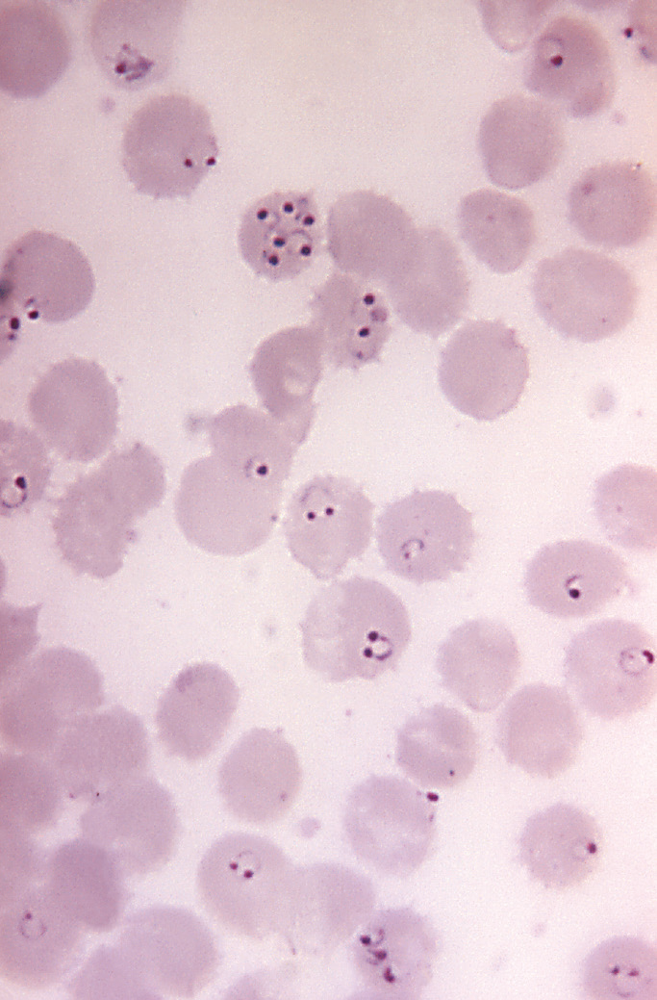

Case Image 1 (Size: (683, 1039), Mode: RGB)
RESPONE FROM MODEL: ["**Predicted disease:**Acute malaria\n**Reason:**The patient's symptoms and signs are consistent with acute malaria, including the abrupt onset of symptoms, fever, rigors, and profuse sweating. The patient also reported taking anti-malarial tablets during her trip, which is a common practice for travelers returning from malaria-endemic areas. Additionally, the patient's temperature and physical examination findings are consistent with a febrile illness caused by malaria."]

CASE 3: 003
ORIGINAL QUERY:
A 72-year-old man who lives in the south of Spain presented in the UK with a progressive illness characterized by fever, malaise, weight loss, and loss of appetite. On examination, he had temperatures up to 39°C and progressive, marked hepatosplenomegaly. Blood tests revealed pancytopenia, and he did not respond to broad-spectrum antibiotics. A bone marrow examination was negative for malignancy and initial stains for organi

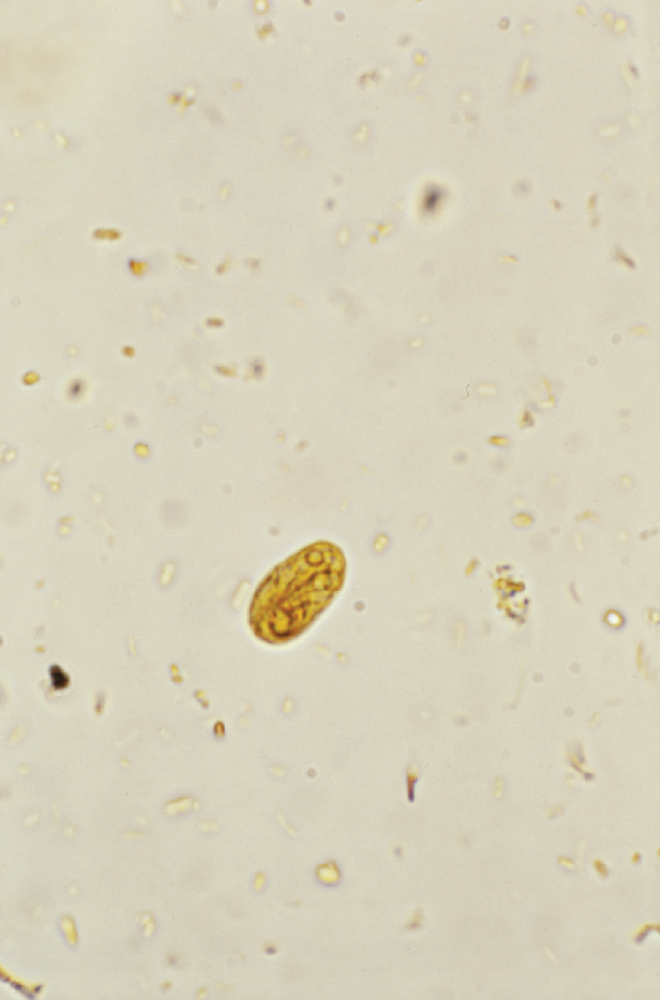

Case Image 1 (Size: (682, 1033), Mode: RGB)

🖼️ IMAGE 2/3 FOR THIS CASE:


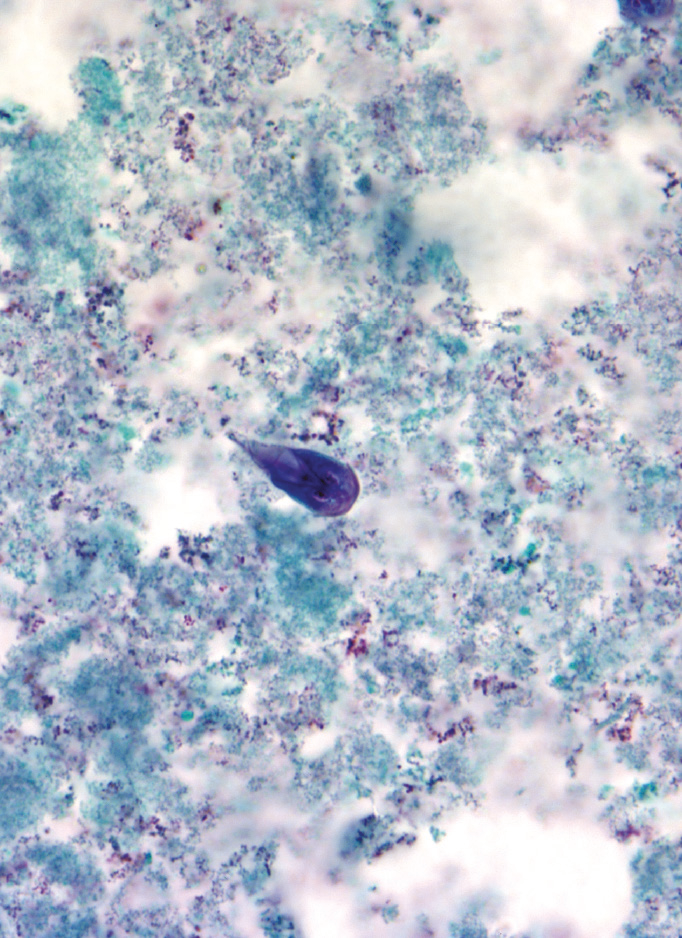

Case Image 2 (Size: (682, 938), Mode: RGB)

🖼️ IMAGE 3/3 FOR THIS CASE:


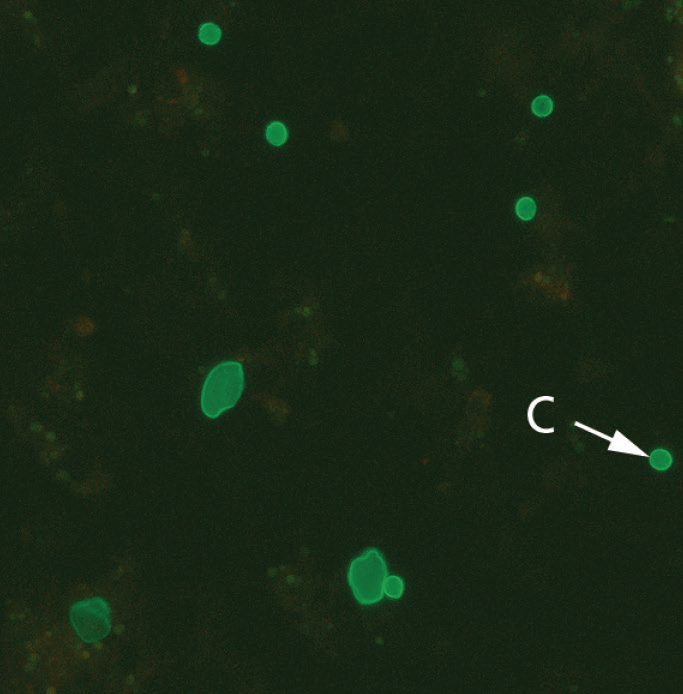

Case Image 3 (Size: (683, 694), Mode: RGB)
RESPONE FROM MODEL: ["**Predicted disease:**Giardiasis\n**Reason:**The patient's symptoms are consistent with giardiasis, as he experienced watery, non-bloody diarrhea, loss of appetite, bloating, flatulence, and difficulty in flushing his stools. The stool microscopy results were positive for reducing substances, which are characteristic of giardiasis. Additionally, the patient's history of backpacking in India, where giardiasis is common, supports the diagnosis."]

CASE 5: 005
ORIGINAL QUERY:
A 60-year-old man from Ohio with a history of rheumatoid arthritis presents with severe dyspnea and cough. His medical history is significant for treatment with methotrexate, methylprednisolone, and infliximab, which was started ten weeks prior to presentation. His symptoms rapidly progressed to respiratory failure requiring mechanical ventilation. A chest radiograph revealed bilateral nodular infiltrates. Bronchoalveolar lavage fluid contained yeast fo

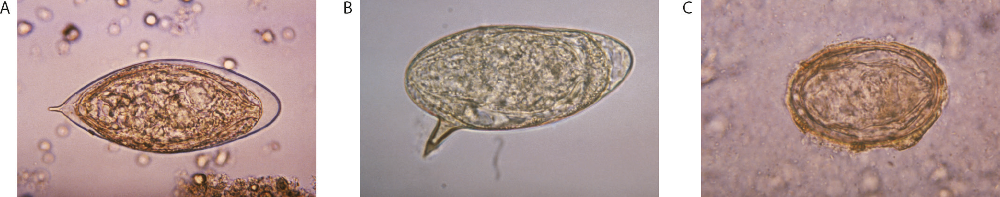

Case Image 1 (Size: (2137, 421), Mode: RGB)

🖼️ IMAGE 2/3 FOR THIS CASE:


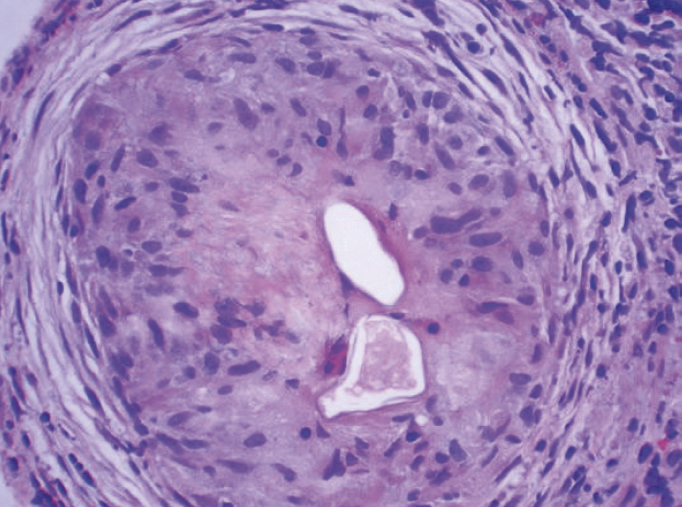

Case Image 2 (Size: (682, 507), Mode: RGB)

🖼️ IMAGE 3/3 FOR THIS CASE:


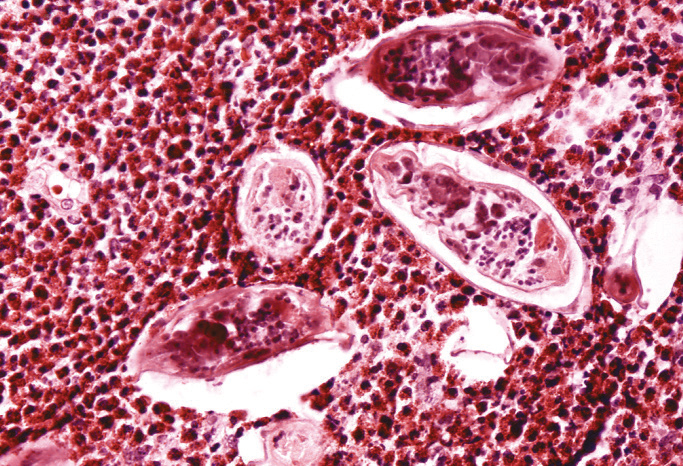

Case Image 3 (Size: (683, 466), Mode: RGB)
RESPONE FROM MODEL: ["**Predicted disease:**Acute schistosomiasis (Katayama syndrome)\n**Reason:**The patient's symptoms and findings are consistent with acute schistosomiasis, as described in the clinical case. The patient's history of frequent swimming in a lake in Kenya, along with the presence of esophageal varices and granulomatous changes in the liver, are all characteristic of Katayama syndrome."]

CASE 8: 008
ORIGINAL QUERY:
A 24-year-old man from Southern India presented with swelling of his left foot that diminishes overnight. He is afebrile and systemically well but reports a history of recurrent episodes of painful, swollen lymph nodes in his groin. On examination, he has enlarged inguinal lymph nodes. Laboratory evaluation was significant for a marked eosinophilia of 1.4×10^9 L–1, while D-dimers were normal. Filarial serology was positive. The patient noted that in his hometown, he had seen individuals with grossly swollen legs.
E

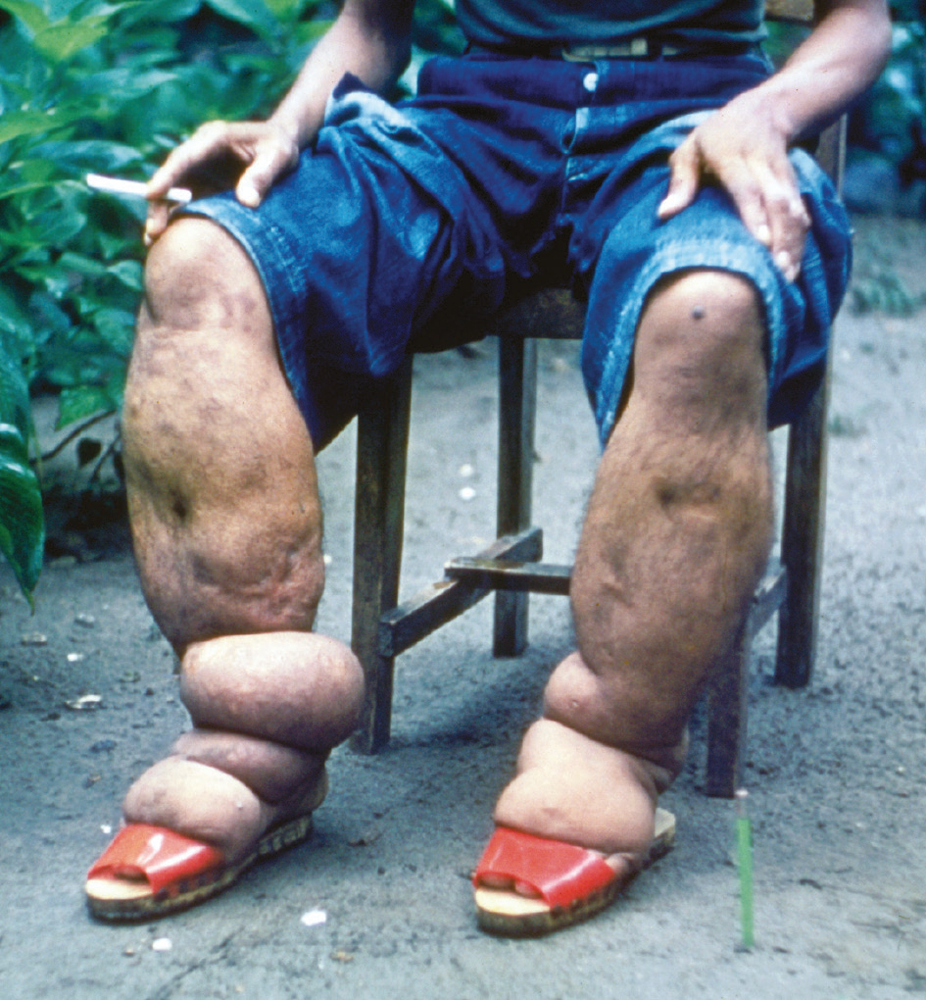

Case Image 1 (Size: (945, 1020), Mode: RGB)

🖼️ IMAGE 2/3 FOR THIS CASE:


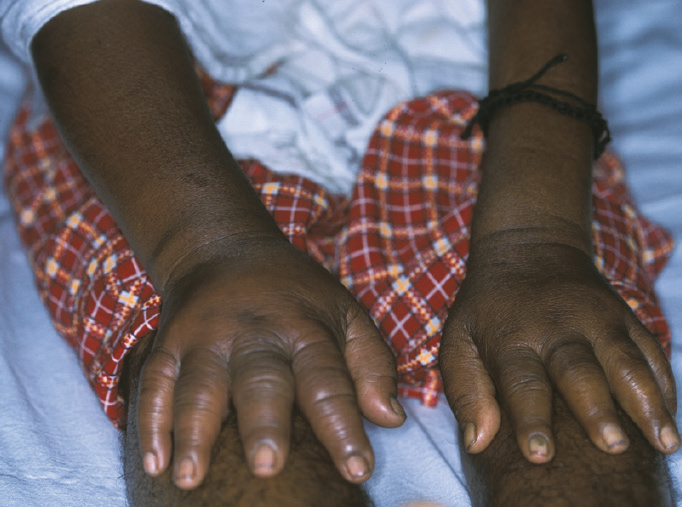

Case Image 2 (Size: (682, 507), Mode: RGB)

🖼️ IMAGE 3/3 FOR THIS CASE:


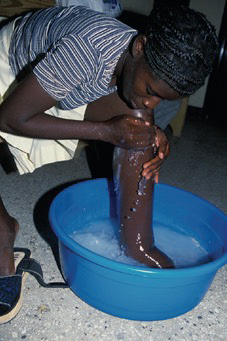

Case Image 3 (Size: (227, 341), Mode: RGB)
RESPONE FROM MODEL: ["**Predicted disease:**Filarial disease\n**Reason:**The patient's symptoms and laboratory findings are consistent with filarial disease, including the marked eosinophilia and positive filarial serology."]

CASE 9: 009
ORIGINAL QUERY:
A 28-year-old Kurdish refugee presented with a four-month history of upper abdominal pain and recent right-sided chest pain. He was afebrile and his weight was stable. An initial chest X-ray showed a mass in the right lung. A subsequent CT scan of the chest and abdomen demonstrated a cystic structure in his liver, with additional cysts in his chest. The right lung lesion was surgically excised for diagnosis. Histopathology of the excised tissue confirmed a parasitic etiology, and serologic tests were also positive.
EXTRACTED AGE: 28
EXTRACTED SYMPTOMS: afebrile
----------------------------------------
The dimension of the embedding vector is: 768
RESOLVED PROMPT: 
 You are diagnosing tropical 

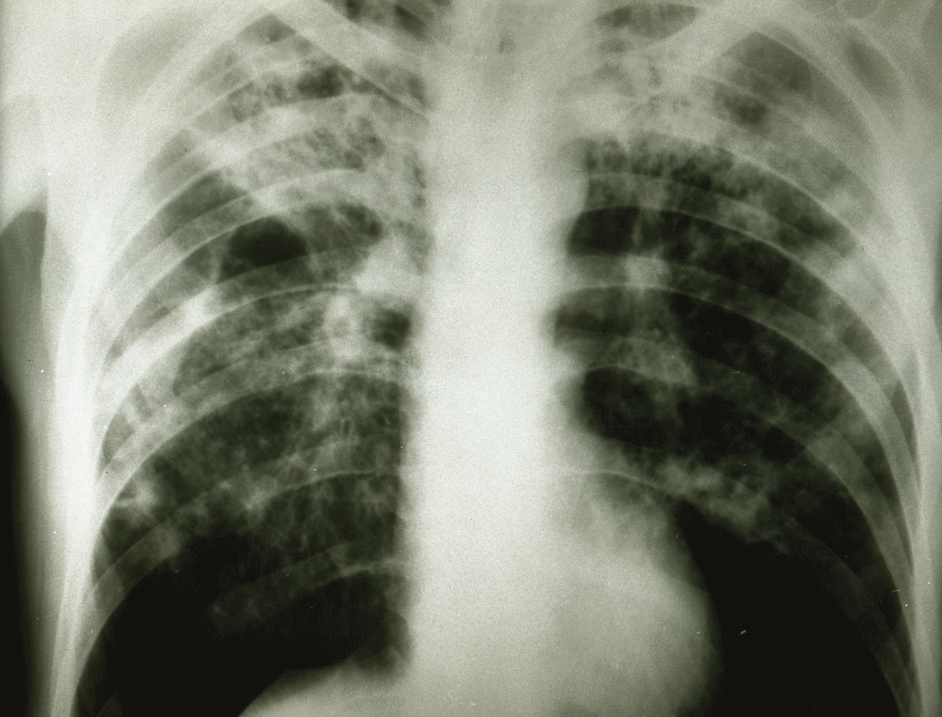

Case Image 1 (Size: (942, 717), Mode: RGB)

🖼️ IMAGE 2/2 FOR THIS CASE:


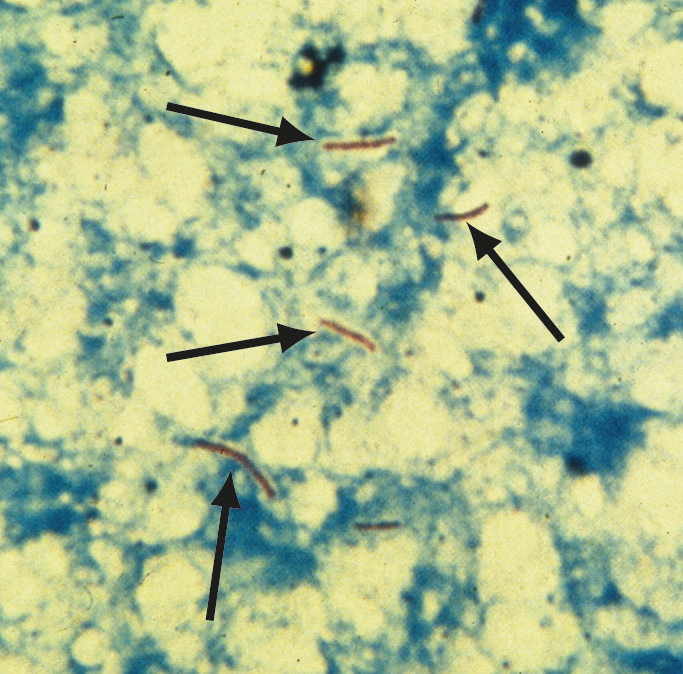

Case Image 2 (Size: (683, 674), Mode: RGB)
RESPONE FROM MODEL: ["**Predicted disease:**Tuberculosis (TB)\n**Reason:**The patient's symptoms and physical examination findings are consistent with TB, including the presence of apical shadowing and a large cavitation on the chest X-ray. The patient's age and the presence of bronchial breathing suggest that TB is the most likely diagnosis."]

CASE 11: 011
ORIGINAL QUERY:
A 32-year-old woman originally from Brazil presented with a sudden onset of left-sided weakness affecting her face, arm, and leg. She also reported recent shortness of breath on exertion. A CT scan of her brain confirmed an acute stroke. Her ECG was abnormal, showing broadened QRS complexes, and a chest X-ray demonstrated cardiomegaly. An echocardiogram revealed a dilated left ventricle with a characteristic apical aneurysm. A small thrombus was noted within the aneurysm, consistent with a cardioembolic source for her stroke.
EXTRACTED AGE: 32
EXTRACTED SYMPTOMS: Acute stro

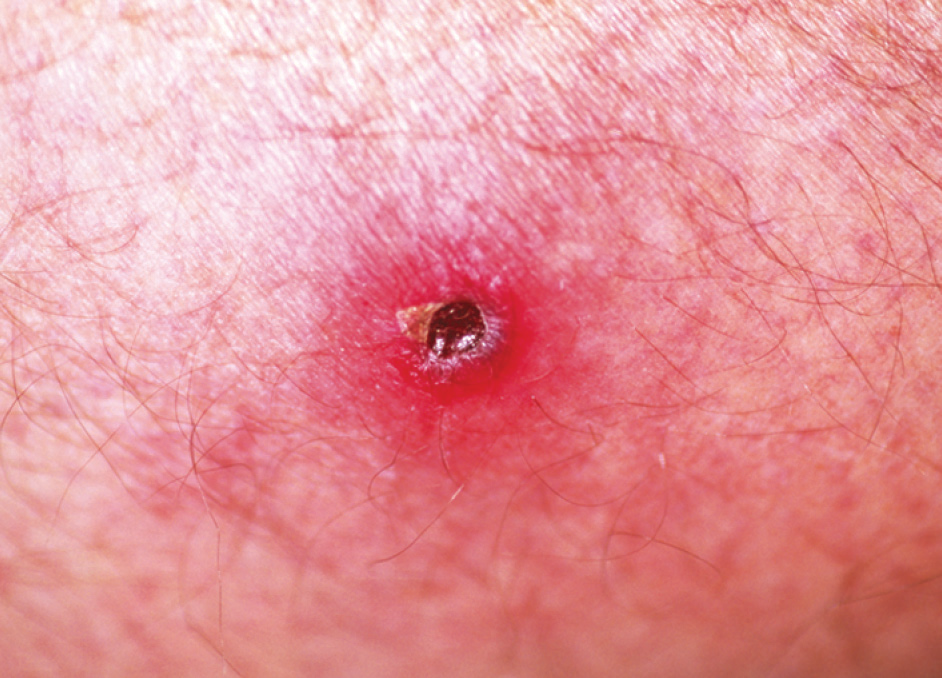

Case Image 1 (Size: (942, 678), Mode: RGB)
RESPONE FROM MODEL: ["**Predicted disease:** African tick-bite fever\n**Reason:** The patient presented with symptoms consistent with African tick-bite fever, including a large, painful tick bite on his thigh, regional lymphadenopathy, and a history of safari travel in an endemic region of Southern Africa. The patient's symptoms and physical examination findings are characteristic of African tick-bite fever, which is caused by Rickettsia africae."]

CASE 13: 013
ORIGINAL QUERY:
A 19-year-old woman presented for a routine gynecologic examination with a complaint of mid-cycle bleeding. She is sexually active with one partner and is taking oral contraceptives. On internal examination, a mucopurulent discharge was noted at the external cervical os. The cervix was also observed to be friable and bled easily on contact. An endocervical swab was collected for testing due to suspicion of a sexually transmitted infection, and the test result was positi

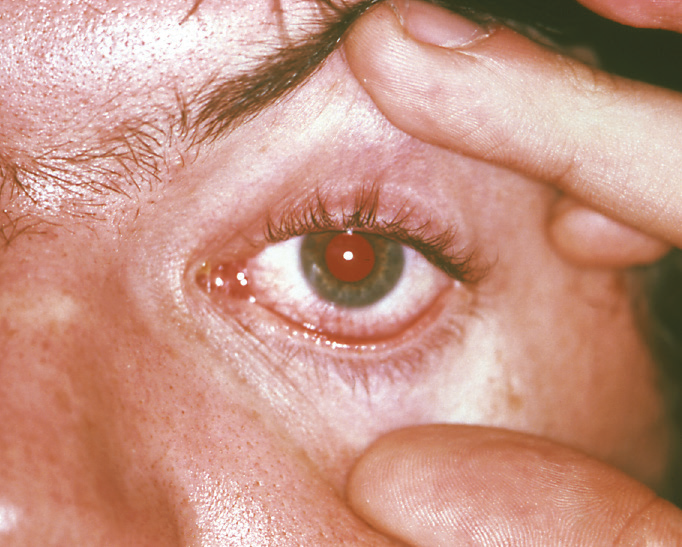

Case Image 1 (Size: (682, 547), Mode: RGB)
RESPONE FROM MODEL: ['**Predicted disease:**Chlamydia trachomatis\n**Reason:**The patient presented with a mucopurulent discharge, which is a common symptom of Chlamydia trachomatis infection. The patient is also taking oral contraceptives, which can increase the risk of sexually transmitted infections. The positive endocervical swab test result further supports the diagnosis of Chlamydia trachomatis.']

CASE 14: 014
ORIGINAL QUERY:
A 37-year-old woman from Southern Mexico presented with a persistent body rash. Her symptoms began five years prior with spasms and needle-like pain in her arms, accompanied by fatigue. She was initially treated for depression and atopic dermatitis. Physical examination revealed numerous hypopigmented skin lesions on her arms, face, abdomen, back, and legs. She also had thinning eyebrows and numbness in her forearm. A skin biopsy was taken from an abdominal lesion for analysis.
EXTRACTED AGE: 37
EXTRACTED SYMPTOMS:

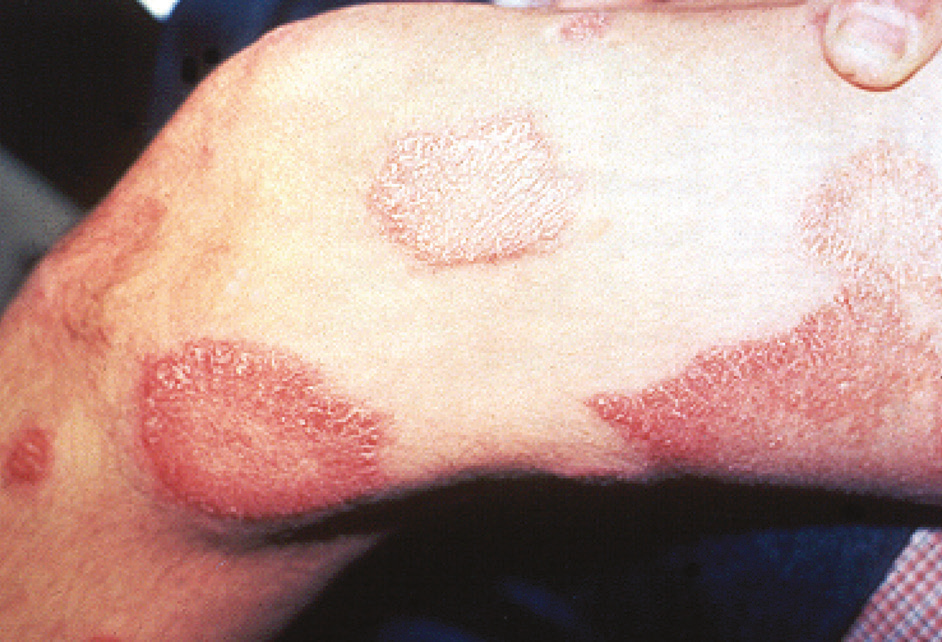

Case Image 1 (Size: (942, 642), Mode: RGB)
RESPONE FROM MODEL: ["**Predicted disease:**Tropical dermatitis\n**Reason:**The patient's symptoms, including the persistent body rash, hypopigmented skin lesions, and thinning eyebrows, are characteristic of tropical dermatitis. This condition is caused by a variety of viruses and bacteria, including Chlamydia trachomatis, Herpes simplex virus, and Mycoplasma pneumoniae. The patient's history of depression and atopic dermatitis suggests a possible underlying immunological or genetic predisposition to these conditions. The skin biopsy results are consistent with the diagnosis of tropical dermatitis, which is a common condition in tropical regions characterized by the development of skin lesions due to viral or bacterial infections."]

CASE 15: 015
ORIGINAL QUERY:
A 40-year-old male from Nepal presented with a four-day history of severe pain, swelling, and discoloration of his left hand. He reported being bitten by a snake on his left little fi

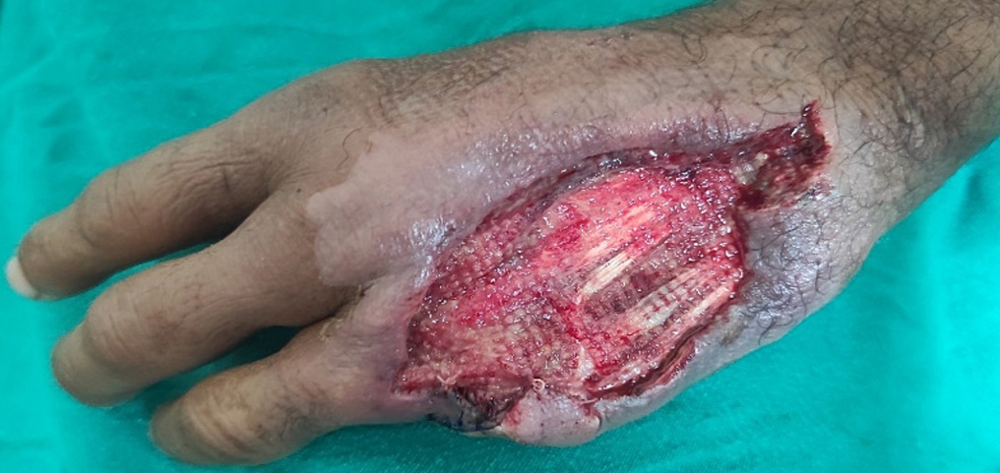

Case Image 1 (Size: (1016, 481), Mode: RGB)

🖼️ IMAGE 2/4 FOR THIS CASE:


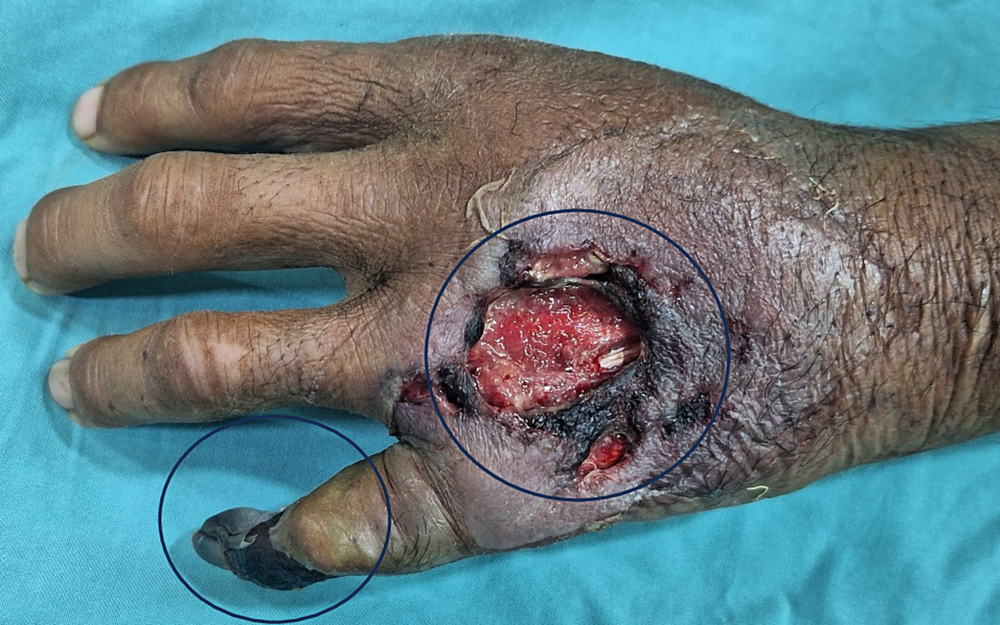

Case Image 2 (Size: (1417, 887), Mode: RGB)

🖼️ IMAGE 3/4 FOR THIS CASE:


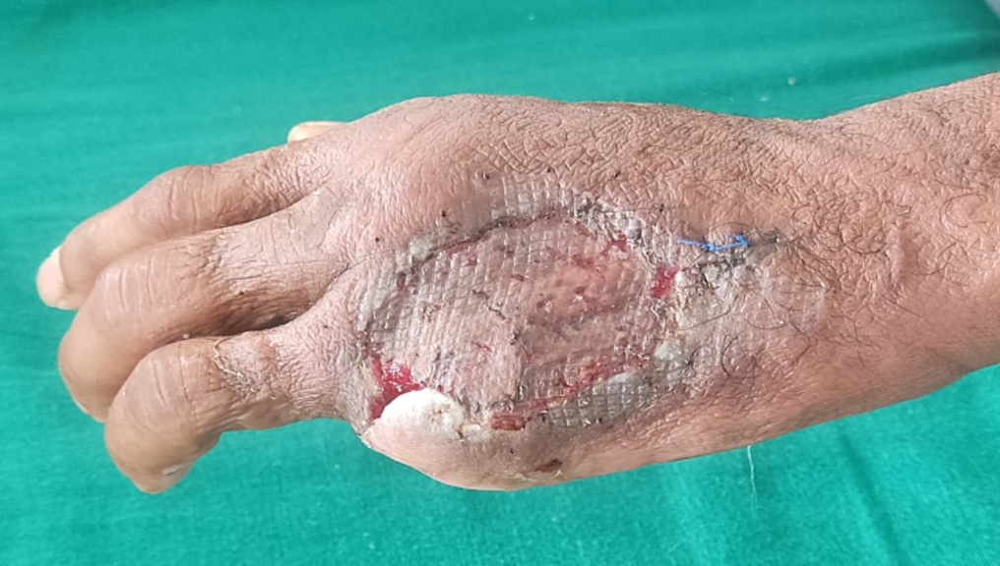

Case Image 3 (Size: (1016, 576), Mode: RGB)

🖼️ IMAGE 4/4 FOR THIS CASE:


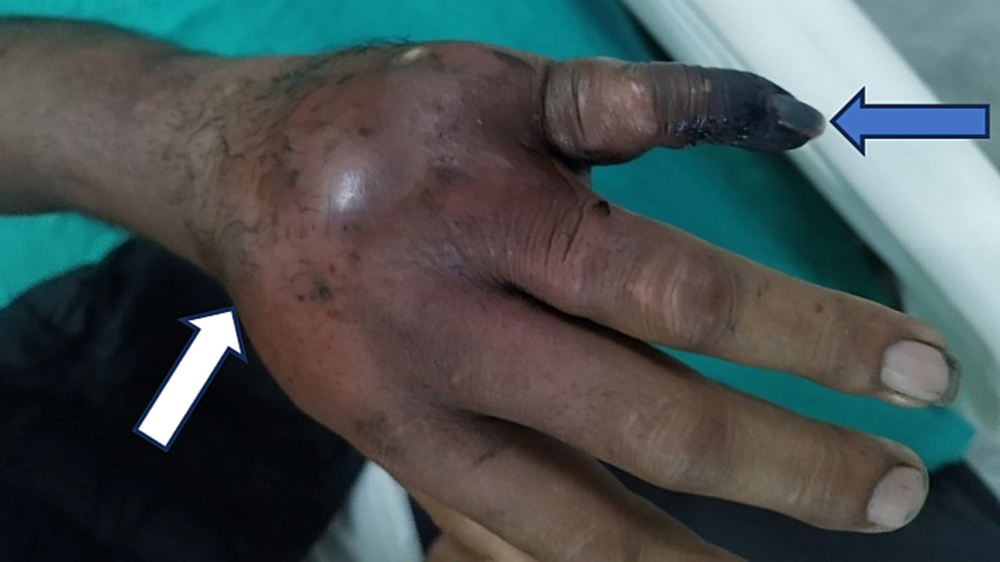

Case Image 4 (Size: (1016, 571), Mode: RGB)
RESPONE FROM MODEL: ['**Predicted disease:**Melioidosis\n**Reason:**The patient presented with a large, tense, fluctuant swelling on the dorsum of his left hand, which is characteristic of a skin and soft tissue abscess. The presence of overlying bluish skin discoloration and the high white blood cell count with a neutrophilic predominance are also consistent with melioidosis.']

CASE 16: 016
ORIGINAL QUERY:
A 34-year-old man with no significant past medical history presented with a two-week illness. His symptoms began with epigastric pain, nausea, decreased appetite, and fevers up to 39°C. One week into the illness, he developed right-sided pleuritic chest pain. On the day of admission, his symptoms persisted, and an abdominal ultrasound was performed. The imaging revealed hepatomegaly and a large, heterogeneous liver lesion measuring 13.4 x 3.6 cm.
EXTRACTED AGE: 34
EXTRACTED SYMPTOMS: hepatomegaly
----------------------------------------
T

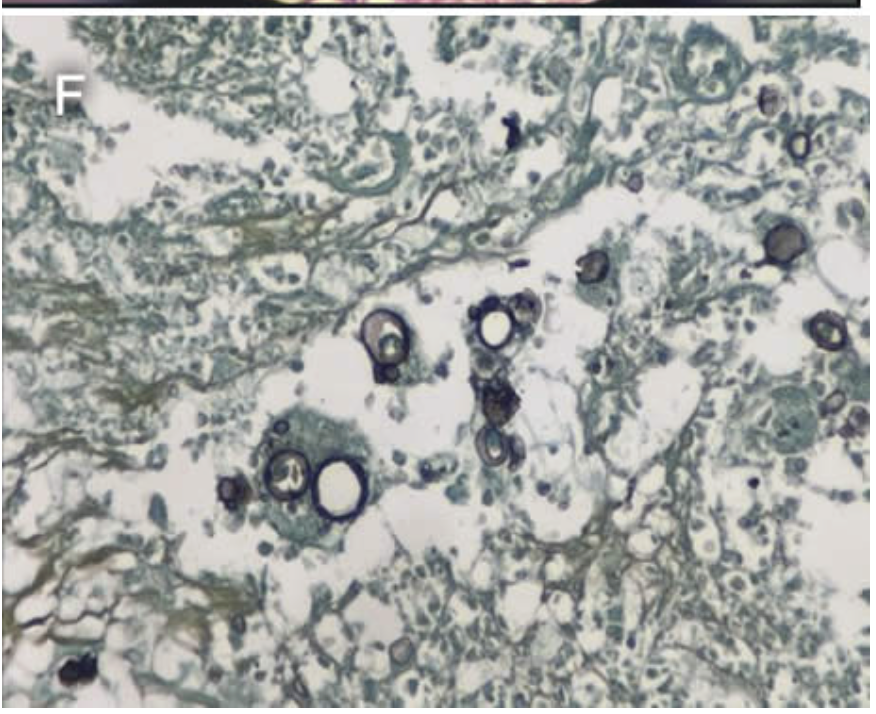

Case Image 1 (Size: (876, 714), Mode: RGB)

🖼️ IMAGE 2/2 FOR THIS CASE:


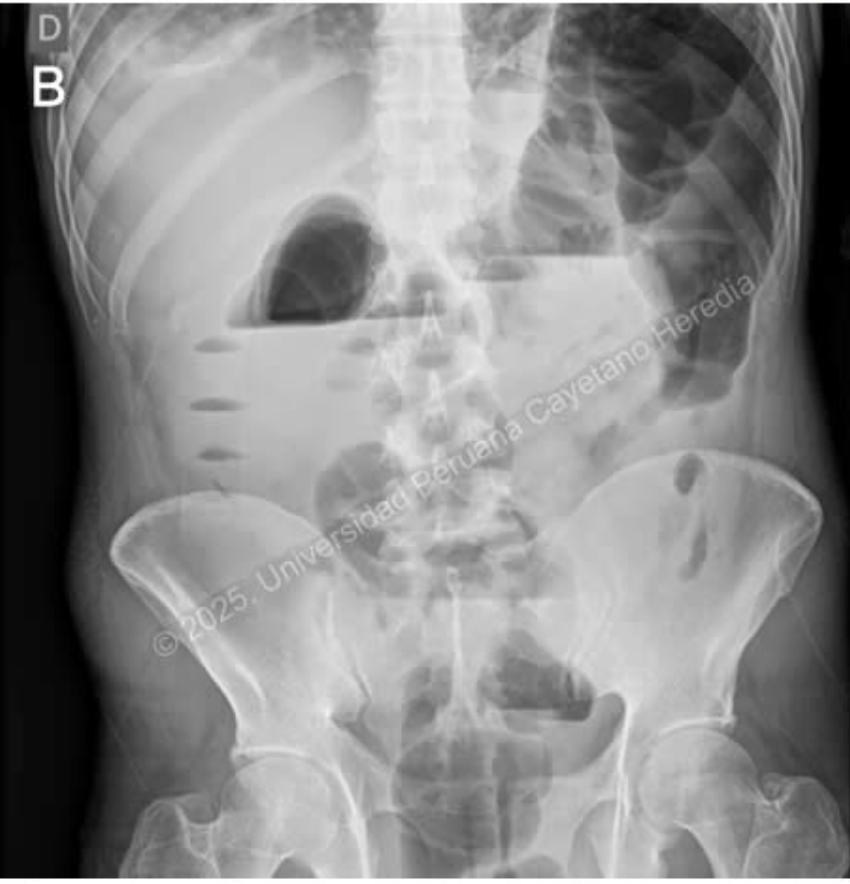

Case Image 2 (Size: (850, 884), Mode: RGB)
RESPONE FROM MODEL: ["**Predicted disease:**Tropical pulmonary eosinophilia\n\n**Reason:** The patient's symptoms and physical examination findings are consistent with tropical pulmonary eosinophilia, a condition characterized by the presence of eosinophils in the blood and lungs. The patient's age, primary symptoms, and the presence of multiple ulcerative and granulomatous lesions in the oropharynx and lungs are all indicative of this condition. The chest radiograph also shows bilateral, mixed interstitial and alveolar infiltrates, which are typical of this condition."]

CASE 19: 019
ORIGINAL QUERY:
An 18-year-old female presents with a five-day history of abrupt onset fever, shaking chills, generalized malaise, headache, and myalgias. She also reports nausea, vomiting, and dark urine that began two days prior to admission. Her symptoms began eight days after she returned from an 8-day trip to a jungle region in Iquitos, Peru. During her trip

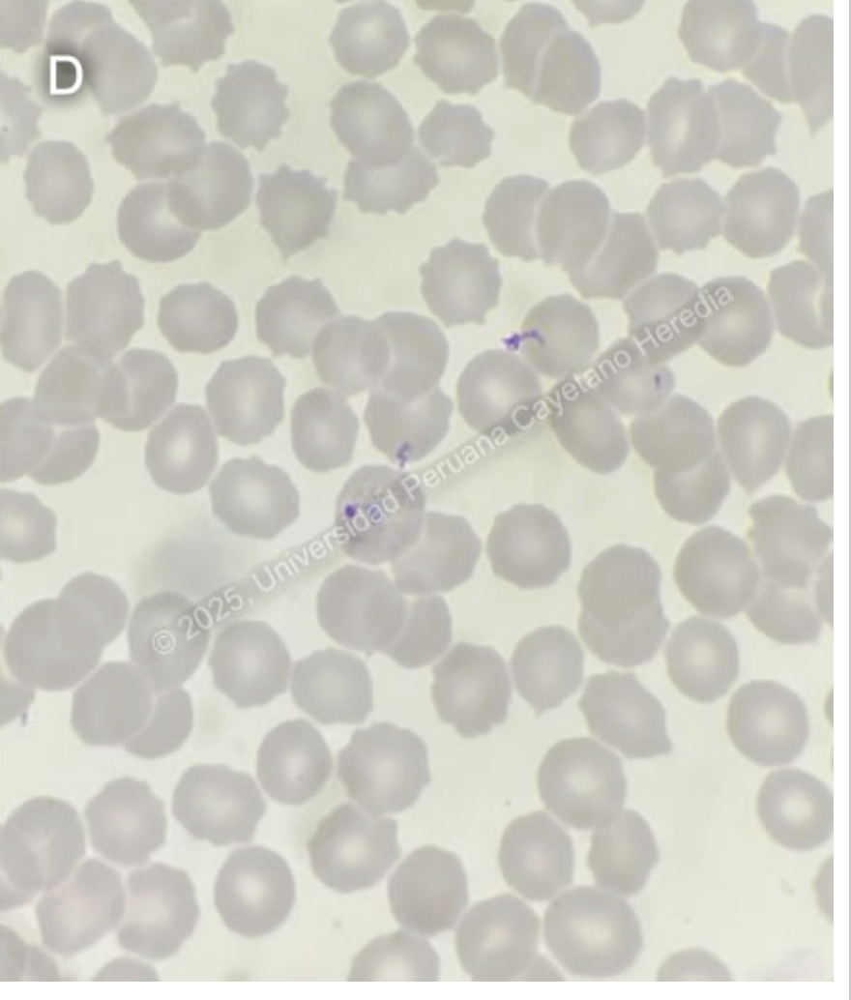

Case Image 1 (Size: (880, 1034), Mode: RGB)
RESPONE FROM MODEL: ["**Predicted disease:**Acute bartonellosis (Oroya fever)\n**Reason:**The patient's symptoms and physical examination are consistent with acute bartonellosis, as evidenced by the presence of massive red blood cell infestation with pleomorphic cocco-bacillary structures on a thin blood smear. The patient's travel history to an endemic region in the Peruvian Andes, along with the specific exposure to sandfly vectors, is also consistent with bartonellosis."]

CASE 20: 020
ORIGINAL QUERY:
A 68-year-old man with a history of benign prostatic hyperplasia presented with a chronic dermatological complaint. For the past seven months, he has developed scaly skin lesions spread across his body. The lesions are associated with severe and persistent itching. The condition has been progressive over this multi-month period. No other systemic symptoms or relevant exposures are mentioned in the initial history.
EXTRACTED AGE: 68
EXTRACTED 

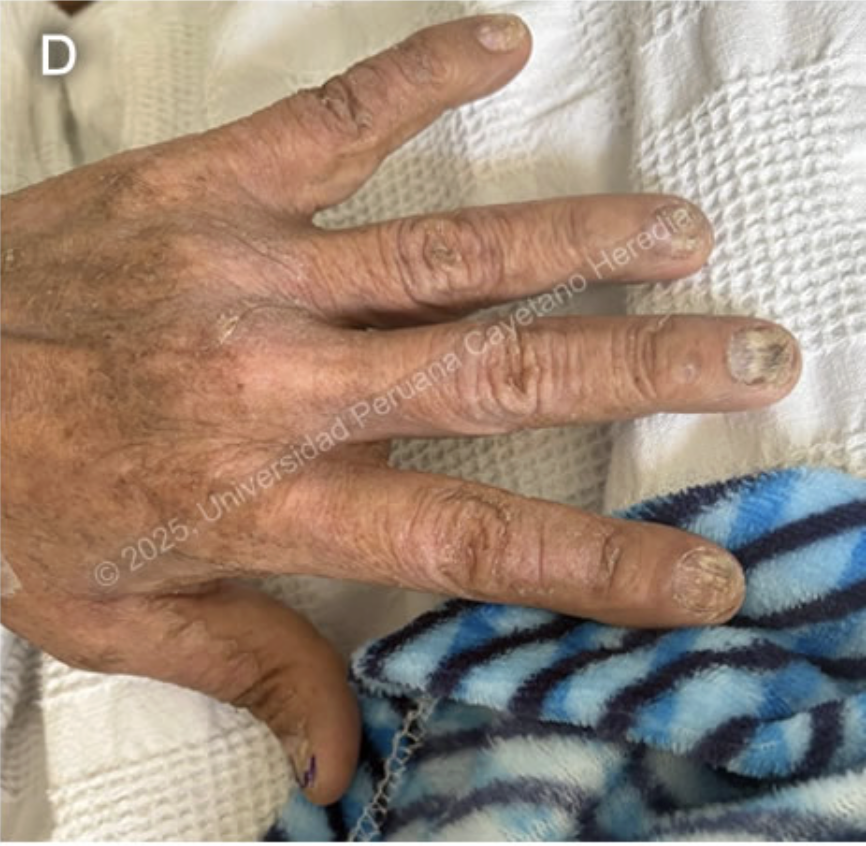

Case Image 1 (Size: (866, 846), Mode: RGB)

🖼️ IMAGE 2/4 FOR THIS CASE:


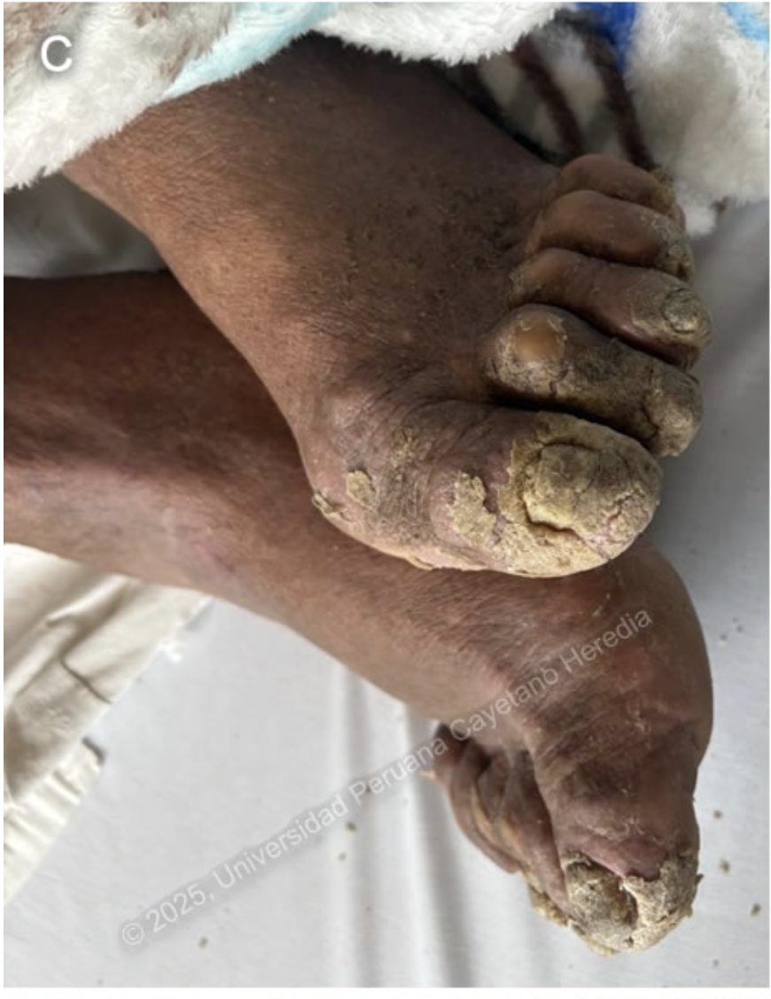

Case Image 2 (Size: (870, 1128), Mode: RGB)

🖼️ IMAGE 3/4 FOR THIS CASE:


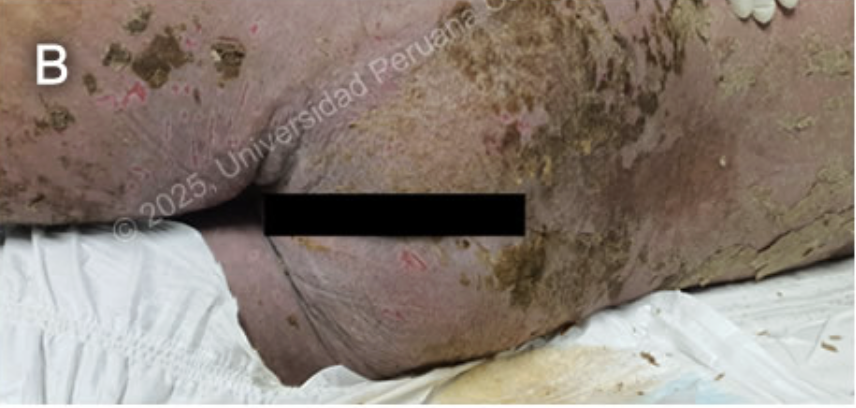

Case Image 3 (Size: (856, 408), Mode: RGB)

🖼️ IMAGE 4/4 FOR THIS CASE:


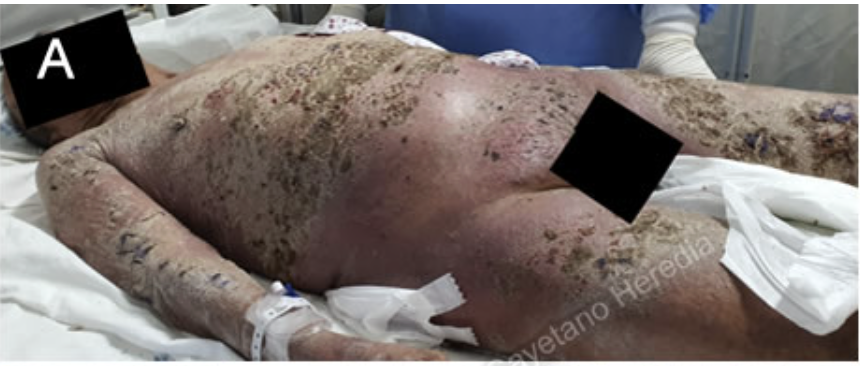

Case Image 4 (Size: (860, 366), Mode: RGB)
RESPONE FROM MODEL: ["**Predicted disease:**Tropical dermatitis\n**Reason:**The patient's primary symptoms of scaly skin lesions spread across his body and severe and persistent itching are characteristic of tropical dermatitis. This condition is commonly seen in tropical regions and is caused by various pathogens, including viruses, fungi, and bacteria. The patient's age and the progression of the condition over multiple months are also consistent with tropical dermatitis."]

CASE 21: 021
ORIGINAL QUERY:
A female neonate was born in the Democratic Republic of Congo to a 22-year-old mother who was diagnosed with Ebola virus disease via PCR at 34 weeks of gestation. The mother recovered after one week of supportive care. The infant was delivered vaginally at 38 weeks gestation with excellent Apgar scores and a normal physical examination. Multiple diagnostic tests were performed on the newborn at birth. Umbilical cord blood PCR, peripheral bloo

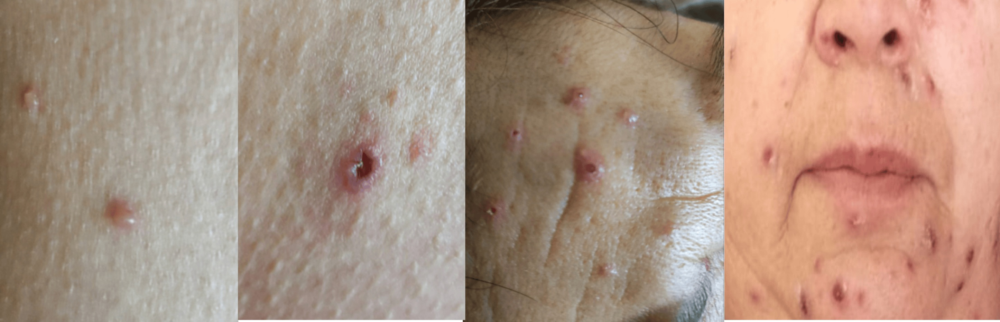

Case Image 1 (Size: (2892, 934), Mode: RGB)
RESPONE FROM MODEL: ["**Predicted disease:**Tropical pulmonary nodules\n**Reason:**The patient's symptoms and physical examination findings are consistent with tropical pulmonary nodules, which are a common complication of rheumatoid arthritis. The patient's history of travel to a coastal area and the presence of multiple skin lesions in various stages of evolution are also suggestive of this diagnosis."]

CASE 29: 029
ORIGINAL QUERY:
A 27-year-old Ugandan woman with a 10-year history of well-controlled HIV presented with a two-month history of worsening right lower abdominal pain and low-grade fevers. She had a remote history of lower back pain treated as lumbago two years prior, but denied recent constitutional symptoms like cough or weight loss. Examination revealed a palpable, tender mass in the right iliac fossa and a gibbus deformity with tenderness over the lumbar spine. An initial ultrasound suggested a psoas abscess. A subsequent abd

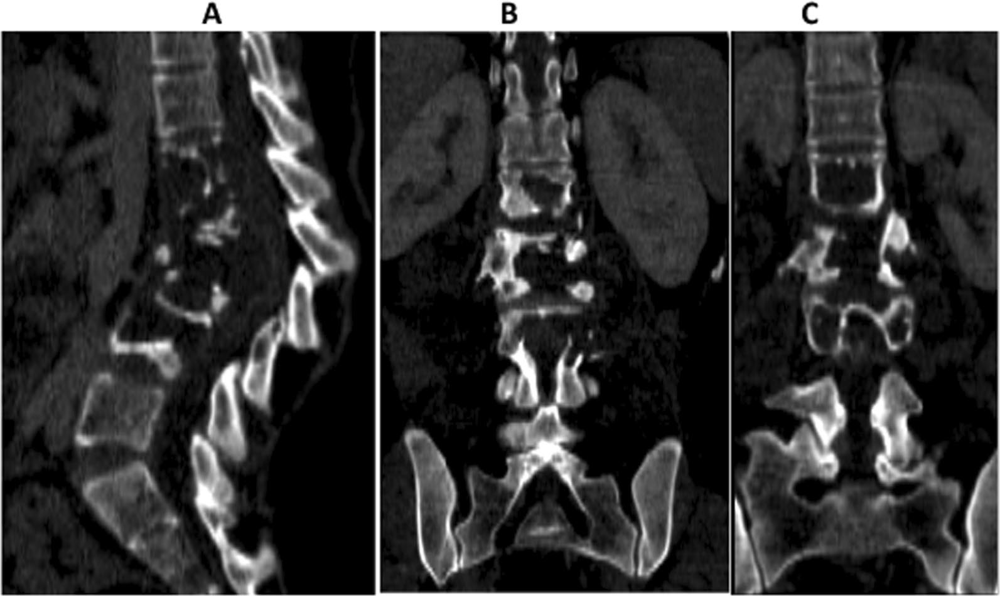

Case Image 1 (Size: (1593, 951), Mode: RGB)
RESPONE FROM MODEL: ["**Predicted disease:** Spinal tuberculosis (Pott's disease)\n**Reason:** The patient's symptoms and imaging findings are consistent with spinal tuberculosis, which is a common tropical disease caused by Mycobacterium tuberculosis. The patient's history of HIV and the presence of a psoas abscess suggest a tropical etiology. The CT scan shows extensive lytic destruction of the vertebral bodies and a large, rim-enhancing paravertebral cystic mass, which are characteristic of spinal tuberculosis."]

CASE 30: 030
ORIGINAL QUERY:
A 10-year-old Tibetan girl presented with a two-month history of moderate to severe headache and nonprojectile vomiting. She had no fever or initial seizures. An important epidemiological clue was that six of her schoolmates presented with similar symptoms and were suspected of having cysticercosis. Laboratory tests showed a mild peripheral eosinophilia and slightly elevated protein and white blood ce

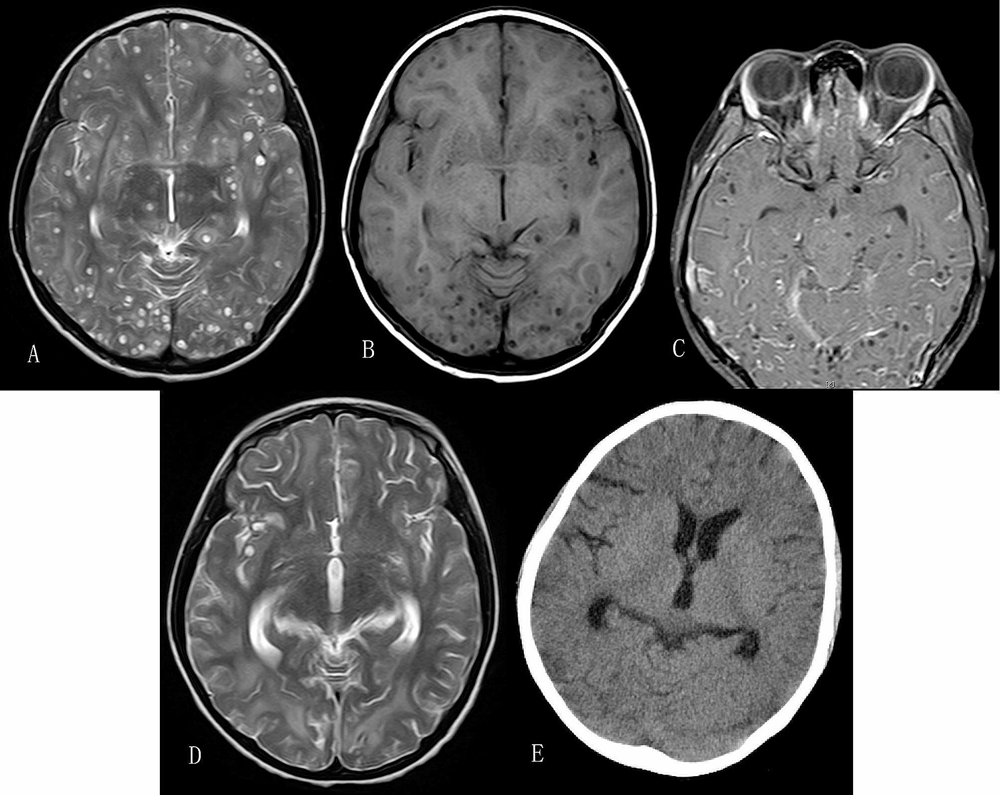

Case Image 1 (Size: (2008, 1598), Mode: RGB)
RESPONE FROM MODEL: ["**Predicted disease:**Cysticercosis\n**Reason:**The patient's symptoms, including headache and nonprojectile vomiting, are consistent with the clinical presentation of cysticercosis. The presence of multiple cystic lesions throughout the cerebral hemispheres, brain stem, and cerebellum on the brain MRI, along with the positive serum ELISA for IgG antibodies against cysticerci, are also indicative of cysticercosis."]

CASE 31: 031
ORIGINAL QUERY:
A 49-year-old man was hospitalized for fever, rigors, and diarrhea. His medical history is significant for a trip to Peru eight weeks prior. Shortly after returning, he experienced a week-long febrile illness with myalgia, which resolved. However, his symptoms of fever and rigors recurred, and he developed multiple red vascular cutaneous nodules on his trunk and legs. On admission, laboratory tests revealed anemia (Hb 8.3 g/dl), an elevated white blood cell count, and a high C-r

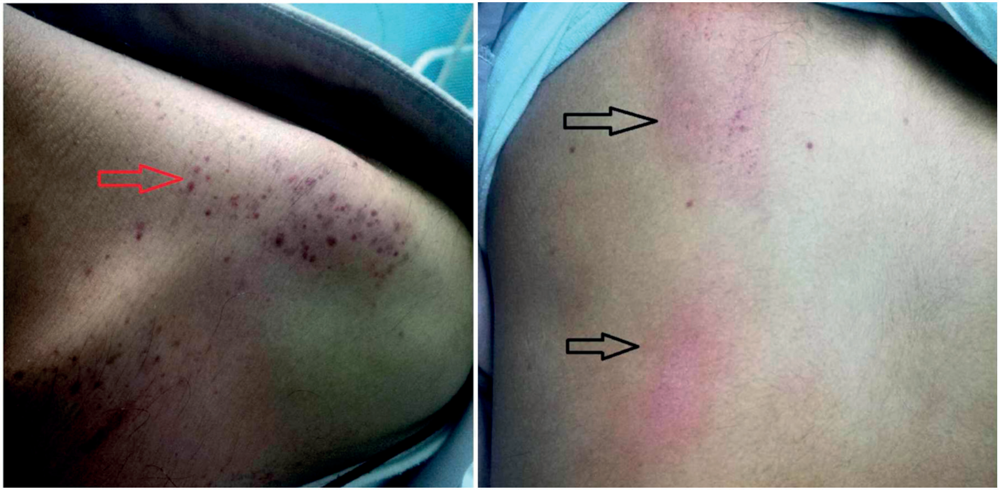

Case Image 1 (Size: (1810, 890), Mode: RGB)
RESPONE FROM MODEL: ["**Predicted disease:**Tropical pulmonary edema\n**Reason:**The patient's symptoms and physical findings are consistent with tropical pulmonary edema, a condition characterized by high-grade intermittent fever, rigors, chills, headache, retro-orbital pain, myalgia, and purpura and petechiae on the skin. The low platelet count and low white blood cell count are also consistent with the diagnosis of tropical pulmonary edema."]

Processed 33 cases.


In [ ]:
import os
import re
import time
import yaml
from pathlib import Path
import matplotlib.pyplot as plt
from typing import Any, Dict, List, Optional, Tuple
from transformers import pipeline

import torch
from PIL import Image as PILImage
import requests
from PIL import Image  # Added import
from IPython import display as ipy_display

from functools import lru_cache
import torch
from transformers import AutoTokenizer, AutoModelForSeq2SeqLM

# Configure dataset path and inference options
TEST_DATA_ROOT = Path("/content/drive/MyDrive/Data/Test-Data/extracted-data")
USE_RAG = False  # Set True to enable retrieval with the original case text
MAX_CASES = None  # Set to an integer to cap processed cases
KEYWORD_MODEL_DEFAULT = os.getenv("RAG_KEYWORD_MODEL", "google/flan-t5-base")
KEYWORD_PROMPT_DEFAULT = os.getenv(
    "RAG_KEYWORD_PROMPT",
    (
        "Extract up to {max_keywords} concise clinical keywords or short phrases "
        "from the following request. Return only a comma-separated list without numbering.\n"
        "Request: {prompt}"
    ),
)

@lru_cache(maxsize=4)
def _load_seq2seq(model_id: str):
    device = "cuda" if torch.cuda.is_available() else "cpu"
    tok = AutoTokenizer.from_pretrained(model_id)
    mdl = AutoModelForSeq2SeqLM.from_pretrained(model_id).to(device)
    mdl.eval()
    return tok, mdl, device

def _seq2seq_generate(model_id: str, text: str, max_new_tokens: int = 64, **gen_kwargs) -> str:
    tok, mdl, device = _load_seq2seq(model_id)
    inputs = tok(text, return_tensors="pt", truncation=True).to(device)
    with torch.inference_mode():
        out = mdl.generate(
            **inputs,
            max_new_tokens=max_new_tokens,
            do_sample=False,
            **gen_kwargs,
        )
    return tok.decode(out[0], skip_special_tokens=True).strip()

def extract_keywords_with_llm(
    prompt_text: str,
    *,
    max_keywords: int = 6,
    model_id: Optional[str] = None,
    instruction_template: Optional[str] = None,
    **generate_kwargs: Any,
) -> List[str]:
    if not prompt_text or not prompt_text.strip():
        return []

    chosen_model = model_id or KEYWORD_MODEL_DEFAULT
    instruction = (instruction_template or KEYWORD_PROMPT_DEFAULT).format(
        max_keywords=max_keywords,
        prompt=prompt_text.strip(),
        user_prompt=prompt_text.strip(),
    )

    generated = _seq2seq_generate(
        chosen_model,
        instruction,
        max_new_tokens=128,
        **generate_kwargs,
    )

    raw_tokens = re.split(r"[\n,;]|\band\b", generated)
    seen: set[str] = set()
    keywords: List[str] = []
    for token in raw_tokens:
        cleaned = token.strip("\t :.-\u2022\u2023\uf0b7")
        if not cleaned:
            continue
        lowered = cleaned.lower()
        if lowered in seen:
            continue
        seen.add(lowered)
        keywords.append(cleaned)
        if len(keywords) >= max_keywords:
            break
    return keywords



def derive_prompt_variables(
    user_prompt: str,
    symptom_limit: int = 12,
    age_model_id: Optional[str] = None,
    symptom_model_id: Optional[str] = None,
) -> Dict[str, Any]:
    """Build template variables via the keyword LLM to keep prompts DRY."""
    if not user_prompt or not user_prompt.strip():
        return {}
    variables: Dict[str, Any] = {}

    # Extract age using regex
    age_match = re.search(r'(\d{1,3})\s*[- ]?\s*(year|years|yr|yo|y/o)[- ]?(old)?', user_prompt.lower())
    if age_match:
        try:
            variables["age"] = int(age_match.group(1))
        except ValueError:
            variables["age"] = "unknown"
    else:
        # Fallback to LLM if regex fails
        age_instruction = (
            "Extract the patient's age from the statement. "
            "Respond with a single number if the age is given, otherwise respond with NONE.\n"
            "Patient statement: {prompt}"
        )
        age_candidates = extract_keywords_with_llm(
            user_prompt,
            max_keywords=1,
            model_id=age_model_id,
            instruction_template=age_instruction,
        )
        for token in age_candidates:
            digit_match = re.search(r"\d{1,3}", token)
            if digit_match:
                try:
                    variables["age"] = int(digit_match.group())
                    break
                except ValueError:
                    continue

    # Extract symptoms
    symptom_instruction = (
        "List up to {max_keywords} concise clinical symptoms or findings mentioned by the patient. "
        "Return a comma-separated list without numbering.\n"
        "Patient statement: {prompt}"
    )
    symptoms = extract_keywords_with_llm(
        user_prompt,
        max_keywords=symptom_limit,
        model_id=symptom_model_id,
        instruction_template=symptom_instruction,
    )
    if symptoms:
        variables["symptoms"] = ", ".join(symptoms)

    # Set defaults
    if "age" not in variables:
        variables["age"] = "unknown"
    if "symptoms" not in variables:
        variables["symptoms"] = "unspecified"

    return variables

def find_case_images(case_dir: Path) -> List[Path]:
    exts = {".jpg", ".jpeg", ".png", ".bmp", ".tiff", ".tif", ".webp"}
    files = []
    for ext in exts:
        files += list(case_dir.glob(f"*{ext}"))
        files += list(case_dir.glob(f"*{ext.upper()}"))

    images_dir = case_dir / "images"
    if images_dir.exists():
        for ext in exts:
            files += list(images_dir.glob(f"*{ext}"))
            files += list(images_dir.glob(f"*{ext.upper()}"))

    return sorted(set(files))

def load_images_for_model(
    case_dir: Path,
    *,
    max_images: int = 4,
    max_side: int = 768,
) -> Tuple[List[PILImage.Image], List[str], List[str]]:
    """
    Load up to `max_images` images from case_dir (and case_dir/images),
    resize thumbnails, and return:
      - images: List[PIL.Image.Image]
      - paths:  List[str] (filesystem paths)
      - uris:   List[str] (file:// URIs)
    """
    image_paths = find_case_images(case_dir)
    if not image_paths:
        return [], [], []

    image_paths = image_paths[:max_images]

    images: List[PILImage.Image] = []
    paths: List[str] = []
    uris: List[str] = []

    for p in image_paths:
        try:
            img = PILImage.open(str(p)).convert("RGB")
            img.thumbnail((max_side, max_side))
            images.append(img)

            p_abs = p.resolve()
            paths.append(str(p_abs))
            uris.append(p_abs.as_uri())  # file://...
        except Exception as e:
            print(f"Failed to load image {p.name}: {e}")

    return images, paths, uris


def display_image(image: PILImage.Image, title: str = "Image"):
    """Display image in notebook or fallback to matplotlib."""
    try:
        ipy_display.display(image)
        print(f"{title} (Size: {image.size}, Mode: {image.mode})")
    except Exception:
        print(f"{title} - Image loaded (Size: {image.size}, Mode: {image.mode})")
        try:
            plt.figure(figsize=(8, 6))
            plt.imshow(image)
            plt.title(title)
            plt.axis("off")
            plt.show()
        except Exception:
            pass

def load_case_images(case_dir: Path):
    image_paths = find_case_images(case_dir)
    loaded_images: List[Image.Image] = []
    loaded_paths: List[str] = []

    for img_path in image_paths:
        try:
            img = Image.open(img_path)
            img.verify()  # check integrity

            img = Image.open(img_path).convert("RGB")  # reopen after verify
            loaded_images.append(img)
            loaded_paths.append(str(img_path))
        except Exception as e:
            print(f"Failed to load image {img_path.name}: {e}")

    return loaded_images, loaded_paths

def render_text_template(
    base_text: Optional[str],
    *,
    template: Optional[str] = None,
    variables: Optional[Dict[str, Any]] = None,
    field_name: str = "prompt",
    defaults: Optional[Dict[str, Any]] = None,
 ) -> str:
    """Render free-form text using a format template when provided."""
    text_value = base_text or ""
    if template:
        template_vars: Dict[str, Any] = {
            "prompt": text_value,
            "user_prompt": text_value,
        }
        if defaults:
            template_vars.update(defaults)
        if variables:
            template_vars.update(variables)
        try:
            rendered = template.format(**template_vars)
        except KeyError as exc:
            missing_key = exc.args[0] if exc.args else "unknown"
            raise ValueError(f"{field_name} template expects variable '{missing_key}'.") from exc
        if rendered.strip():
            return rendered
        if text_value.strip():
            return text_value
        raise ValueError(f"{field_name.title()} template rendered an empty string.")
    if text_value.strip():
        return text_value
    raise ValueError(f"Provide a {field_name} or {field_name} template.")
def display_images(images: List[Image.Image], image_paths: List[str] = None):
    """Display multiple images in notebook or console."""
    for idx, (image, img_path) in enumerate(zip(images, image_paths if image_paths else [f"Image {i+1}" for i in range(len(images))])):
        try:
            # For Jupyter notebook
            display.display(image)
            print(f"📸 Image {idx+1}: {img_path} (Size: {image.size}, Mode: {image.mode})")
        except:
            # For regular console
            print(f"📸 Image {idx+1}: {img_path}")
            print(f"   Size: {image.size}, Mode: {image.mode}")
            # Try to show using matplotlib
            try:
                plt.figure(figsize=(8, 6))
                plt.imshow(image)
                plt.title(f"Image {idx+1}: {os.path.basename(img_path)}")
                plt.axis('off')
                plt.show()
            except:
                print("   (Image visualization not available in this environment)")

def extract_answer_from_response(response) -> str:
    """Extract the answer text from MedGemma's response structure."""
    if not response:
        return "No answer."

    if isinstance(response, list) and len(response) > 0:
        generated_item = response[0]

        if isinstance(generated_item, dict) and "generated_text" in generated_item:
            generated_text = generated_item["generated_text"]

            if isinstance(generated_text, list):
                for msg in reversed(generated_text):
                    if isinstance(msg, dict) and msg.get("role") == "assistant":
                        content = msg.get("content", "")
                        if isinstance(content, list):
                            for chunk in content:
                                if isinstance(chunk, dict) and chunk.get("type") == "text":
                                    return chunk.get("text", "No text found")
                        elif isinstance(content, str):
                            return content
                        return str(content)

                last_msg = generated_text[-1]
                if isinstance(last_msg, dict) and "content" in last_msg:
                    return last_msg["content"]

            elif isinstance(generated_text, str):
                return generated_text

        elif isinstance(generated_item, str):
            return generated_item

    return str(response)

def _extract_predicted_disease(answer: str) -> str:
    """Extract predicted disease from answer text."""
    if not answer:
        return ""

    patterns = [
        r"Predicted disease:\s*(.+)",
        r"Diagnosis:\s*(.+)",
        r"Condition:\s*(.+)",
        r"Disease:\s*(.+)"
    ]

    for pattern in patterns:
        match = re.search(pattern, answer, flags=re.IGNORECASE)
        if match:
            return match.group(1).strip()

    return answer.strip()

def process_single_image(image: Image.Image):
    """Process a single image for the model input.
    You need to implement this based on your specific model requirements."""
    # Example implementation - adjust based on your model
    if hasattr(processor, 'image_processor'):
        return processor.image_processor(image, return_tensors="pt").pixel_values
    else:
        # Fallback: convert to tensor
        import torchvision.transforms as transforms
        transform = transforms.Compose([
            transforms.Resize((224, 224)),
            transforms.ToTensor(),
        ])
        return transform(image).unsqueeze(0)

def run_Qwen2_Rag(
    prompt: Optional[str] = None,
    *,
    prompt_template: Optional[str] = None,
    prompt_variables: Optional[Dict[str, Any]] = None,
    images: Optional[List[PILImage.Image]] = None,
    image_paths: Optional[List[str]] = None,
    system_instruction: str = "You are an expert in tropical diseases.",
    system_instruction_template: Optional[str] = None,
    system_instruction_variables: Optional[Dict[str, Any]] = None,
    rag_query: Optional[str] = None,
    rag_top_k: Optional[int] = 2,
    rag_search_limit: int = 50,
    rag_use_keyword_llm: bool = False,
    rag_keyword_model_id: Optional[str] = None,
    rag_keyword_max_items: int = 10,
    rag_keyword_prompt: Optional[str] = None,
    max_new_tokens: int = 2000,
    temperature: float = 0.0,
    **generate_kwargs: Any,
 ) -> Dict[str, Any]:
    start_time = time.time()
    output: Dict[str, Any] = {
        "answer": None,
        "latency": None,
        "error": None,
        "resolved_prompt": None,
        "resolved_system_instruction": None,
        "input_image_paths": image_paths or [],
        "rag_query_used": None,
        "rag_keywords": [],
    }

    # Render final prompt
    final_prompt = render_text_template(
        prompt,
        template=prompt_template,
        variables=prompt_variables,
        field_name="prompt",
    )
    output["resolved_prompt"] = final_prompt

    # Extract keywords for RAG if enabled
    keyword_query: Optional[str] = None
    extracted_keywords: List[str] = []
    if rag_use_keyword_llm and final_prompt.strip():
        extracted_keywords = extract_keywords_with_llm(
            final_prompt,
            max_keywords=rag_keyword_max_items,
            model_id=rag_keyword_model_id,
            instruction_template=rag_keyword_prompt,
        )
        if extracted_keywords:
            keyword_query = ", ".join(extracted_keywords)
            output["rag_keywords"] = extracted_keywords

    # Gather RAG context
    context_text = ""
    references = []
    if rag_query is not False:
        if isinstance(rag_query, str) and rag_query.strip():
            query_source = rag_query.strip()
        elif keyword_query:
            query_source = keyword_query
        else:
            query_source = final_prompt

        context_text, references= gather_rag_context(query_source,
                                                     top_k=rag_top_k,
                                                     search_limit=rag_search_limit,)
        output["context"] = context_text
        output["references"] = references
        output["rag_query_used"] = query_source

    # Render system instruction
    final_system_instruction = render_text_template(
        system_instruction,
        template=system_instruction_template,
        variables=system_instruction_variables,
        field_name="system instruction",
        defaults={"final_prompt": final_prompt},
    )
    output["resolved_system_instruction"] = final_system_instruction
    # Build system content
    system_content = []
    if context_text:
        system_content.append({"type": "text", "text": f"Context: {context_text}"})
    system_content.append({"type": "text", "text": final_system_instruction})


    print(f"RESOLVED PROMPT: \n {final_prompt}")
    print(f"RESOLVED SYSTEM INSRUCTION:\n {final_system_instruction}")
    print(f"CONTEXT:\n {context_text}")

   # Build user content: MULTI-IMAGE + TEXT
    user_content = []
    if images:
        for idx, img in enumerate(images, start=1):
            print(f"\n🖼️ IMAGE {idx}/{len(images)} FOR THIS CASE:")
            display_image(img, title=f"Case Image {idx}")
            user_content.append({"type": "image", "image": img})

    user_content.append({"type": "text", "text": final_prompt})

    messages = [
        {
            "role": "system",
            "content": system_content,
        },
        {
            "role": "user",
            "content": user_content,
        },
    ]
    # Preparation for inference

    # Prepare model inputs
    text = processor.apply_chat_template(
        messages, tokenize=False, add_generation_prompt=True
    )
    image_inputs, video_inputs = process_vision_info(messages)
    inputs = processor(
        text=[text],
        images=image_inputs,
        videos=video_inputs,
        padding=True,
        return_tensors="pt",
    )
    inputs = inputs.to("cuda")

    # Inference: Generation of the output
    generated_ids = model.generate(**inputs, max_new_tokens=2000)
    generated_ids_trimmed = [
        out_ids[len(in_ids) :] for in_ids, out_ids in zip(inputs.input_ids, generated_ids)
    ]
    response = processor.batch_decode(
        generated_ids_trimmed, skip_special_tokens=True, clean_up_tokenization_spaces=False
    )
    print(f"RESPONE FROM MODEL: {response}")
    # Extract the answer
    output["answer"] = response[0] if response else "No answer."
    extracted_answer = extract_answer_from_response(response)
    output["predicted"] = _extract_predicted_disease(extracted_answer)
    output["input_prompt"] = final_prompt
    output["input_image"] = images if images else None

    return output


def run_diagnosis_testcase(max_cases: int | None = MAX_CASES):
    if not TEST_DATA_ROOT.exists():
        raise FileNotFoundError(f"Test data directory not found: {TEST_DATA_ROOT}")

    results = []
    case_counter = 0

    print(f"Scanning for cases in: {TEST_DATA_ROOT}")

    for case_dir in sorted(TEST_DATA_ROOT.iterdir()):
        if max_cases is not None and case_counter >= max_cases:
            break
        if not case_dir.is_dir():
            continue

        query_path = case_dir / "query.txt"
        if not query_path.exists():
            continue

        # Đọc query
        user_prompt = query_path.read_text(encoding="utf-8").strip()

        # Trích xuất symptoms và age
        prompt_variables = derive_prompt_variables(
            user_prompt=user_prompt,
            symptom_limit=12,
        )
        print("\n" + "="*80)
        print(f"CASE {case_counter + 1}: {case_dir.name}")
        print(f"ORIGINAL QUERY:\n{user_prompt}")
        print(f"EXTRACTED AGE: {prompt_variables.get('age', 'unknown')}")
        print(f"EXTRACTED SYMPTOMS: {prompt_variables.get('symptoms', 'unspecified')}")
        print("-"*40)

        # Load prompt template
        prompt_type = "clinical_qa"
        try:
            with open(f'/content/prompts/medgemma/{prompt_type}.yaml', 'r') as file:
                config = yaml.safe_load(file)
            prompt_template = config['prompt_template']
            system_instruction = config['system_prompt']
        except Exception as e:
            print(f"Warning: Could not load prompt template: {e}")
            # Fallback templates
            prompt_template = "Patient query: {prompt}\n\nPlease provide a diagnosis."
            system_instruction = "You are a medical expert specializing in tropical diseases."

        # Load ALL images
        images, image_paths = load_case_images(case_dir)

        if not images:
            print(f"WARNING: No images found in {case_dir}")
            # vẫn chạy text-only

        # Read ground truth
        ground_truth_path = case_dir / "ground_truth.txt"
        ground_truth = (
            ground_truth_path.read_text(encoding="utf-8").strip()
            if ground_truth_path.exists()
            else ""
        )

        response = run_Qwen2_Rag(
            prompt=user_prompt,
            prompt_template=prompt_template,
            prompt_variables=prompt_variables,
            images=images,
            image_paths=image_paths,
            system_instruction_template= system_instruction,
            system_instruction_variables={
                "specialty": "tropical pulmonary diseases",
                "audience": "clinicians",
                "test_id": case_dir.name
            },
        )

        # Store results
        result_data = {
            "case_id": case_dir.name,
            "input_prompt": response.get("input_prompt"),
            "input_image": image_paths,
            "ground_truth": ground_truth,
            "context": response.get("context"),
            "answer": response.get("answer"),
            "predicted_disease": response.get("predicted"),
            #"model_response":response.get("answer"),
            #"context":response.get("context",""),
            #"resolved_prompt": response.get("resolved_prompt"),
            #"resolved_system_instruction": response.get("resolved_system_instruction"),
        }
        results.append(result_data)
        case_counter += 1

    print(f"\nProcessed {case_counter} cases.")
    return results

## Main
if __name__ == "__main__":
    testcase_results = run_diagnosis_testcase()


In [ ]:
# SAVE TO EXCEL
import pandas as pd

df = pd.DataFrame(testcase_results)
output_path = "/content/testcase_Qwen2_RAG_k2.xlsx"
df.to_excel(output_path, index=False)
print(f"\nExcel saved to: {output_path}")


Excel saved to: /content/testcase_Qwen2_RAG_k2.xlsx


#Save to file

In [ ]:
# SAVE TO EXCEL
import pandas as pd

df = pd.DataFrame(testcase_results)
output_path = "/content/testcase_Qwen2_raw.xlsx"
df.to_excel(output_path, index=False)
print(f"\nExcel saved to: {output_path}")


Excel saved to: /content/testcase_Qwen2_raw.xlsx


In [ ]:
import pandas as pd
df2 = pd.DataFrame(testcase_results)
output_path_2 = "/content/testcase_Qwen2_RAG.xlsx"
df2.to_excel(output_path_2, index=False)
print(f"\nExcel saved to: {output_path_2}")



Excel saved to: /content/testcase_Qwen2_RAG.xlsx
